In [1]:
import os
import re
from typing import Dict
import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
from harmonypy import run_harmony
import matplotlib.pyplot as plt

import integration as it
import tmpPypkg.globalvar as gv
from tmpPypkg.singlecell import normalize_data
from tmpPypkg.plot import categorical_scatter

In [2]:
%matplotlib inline
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [3]:
# meta
projd = gv.pt_projd
palette = {
    '01 IT-ET Glut': '#FA0087',
    '02 NP-CT-L6b Glut': '#61e2a4',
    '03 OB-CR Glut': '#D00000',
    '04 DG-IMN Glut': '#16f2f2',
    '05 OB-IMN GABA': '#1b4332',
    '06 CTX-CGE GABA': '#CCFF33',
    '07 CTX-MGE GABA': '#f954ee',
    '08 CNU-MGE GABA': '#70E000',
    '09 CNU-LGE GABA': '#B199FF',
    '10 LSX GABA': '#3283FE',
    '11 CNU-HYa GABA': '#450099',
    '12 HY GABA': '#FF6600',
    '13 CNU-HYa Glut': '#90E0EF',
    '14 HY Glut': '#AA0DFE',
    '15 HY Gnrh1 Glut': '#F28266',
    '16 HY MM Glut': '#01d669',
    '18 TH Glut': '#0D47A1',
    '19 MB Glut': '#007200',
    '20 MB GABA': '#9EF01A',
    '21 MB Dopa': '#38B000',
    '22 MB-HB Sero': '#EC4067',
    '23 P Glut': '#6b5ca5',
    '26 P GABA': '#72195a',
    '30 Astro-Epen': '#594a26',
    '31 OPC-Oligo': '#03045E',
    '33 Vascular': '#858881',
    '34 Immune': '#825f45'
}

In [5]:
# input data can be anndata or xr.array
def draw_single_group_umap(
    d, 
    ax,
    hue = None,
    pal = "auto",
    base = "umap",
    nmax = 100000,
    title = "UMAP",
    color = "lightcoral",
    rasterized = True,
    labelsize = 10,
    titlesize = 25
) -> None: 
    categorical_scatter(
        data = d,
        hue = hue,
        palette = pal,
        coord_base = base,
        max_points = nmax,
        color = color,
        return_fig = False,
        rasterized = rasterized,
        ax = ax,
        labelsize = labelsize
    )
    ax.set_title(title, fontsize=titlesize)
    return None

AnnData object with n_obs × n_vars = 635048 × 50
    obs: 'barcode', 'batch', 'leiden', 'class'
    uns: 'leiden', 'leiden_sizes', 'neighbors', 'paga'
    obsm: 'X_harmony', 'X_umap', 'X_umap_hm', 'raw_pca'
    obsp: 'connectivities', 'distances'

batch
PariedTag     238159
Allen10Xv3    182226
snATAC        162569
snmC           52094
Name: count, dtype: int64

['Allen10Xv3', 'PariedTag', 'snmC', 'snATAC']
Categories (4, object): ['Allen10Xv3', 'PariedTag', 'snATAC', 'snmC']

/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(


Text(0.5, 1.0, 'UMAP of All the Modalities')

/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(


Text(0.5, 1.0, 'UMAP of All the Modalities')

/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/text_anno_scatter.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for text, sub_df in data.groupby(anno_col):
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/text_anno_scatter.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for text, sub_df in data.groupby(anno_col):
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/text_anno_scatter.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observe

Text(0.5, 1.0, 'UMAP of All the Modalities')

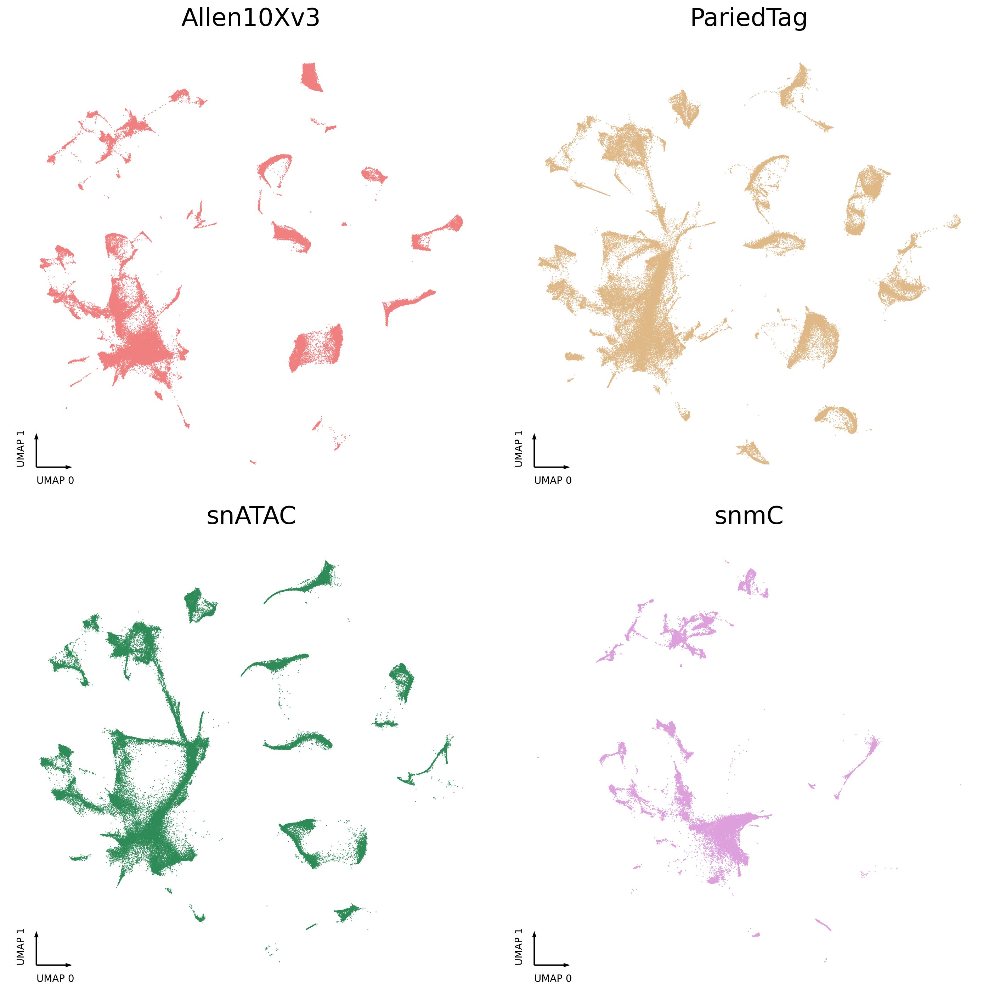

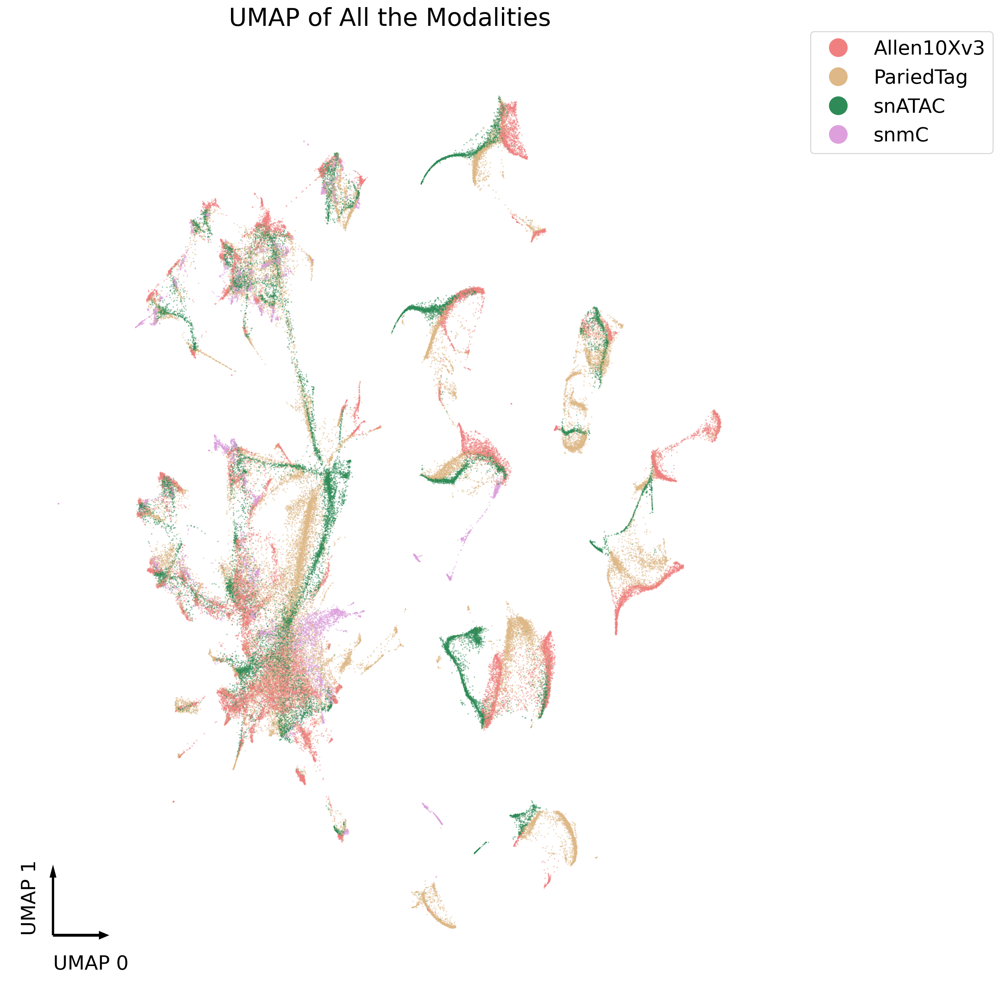

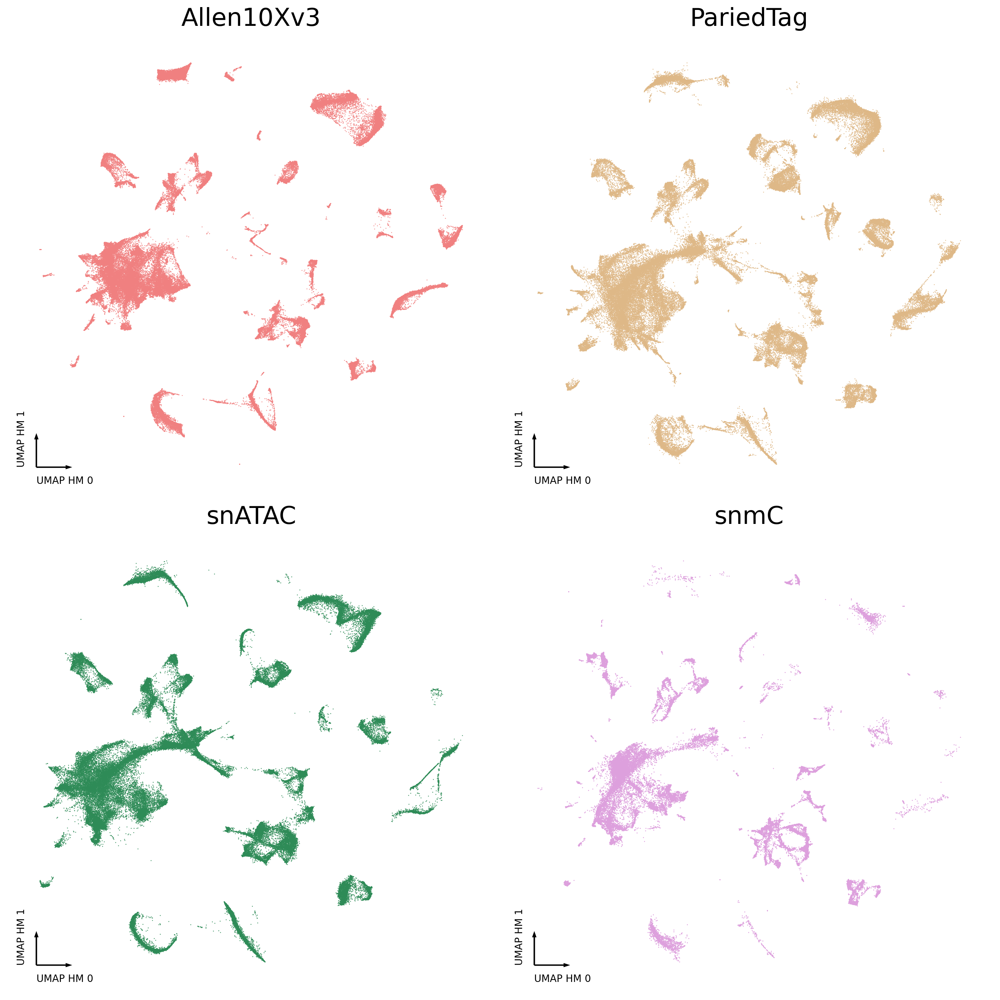

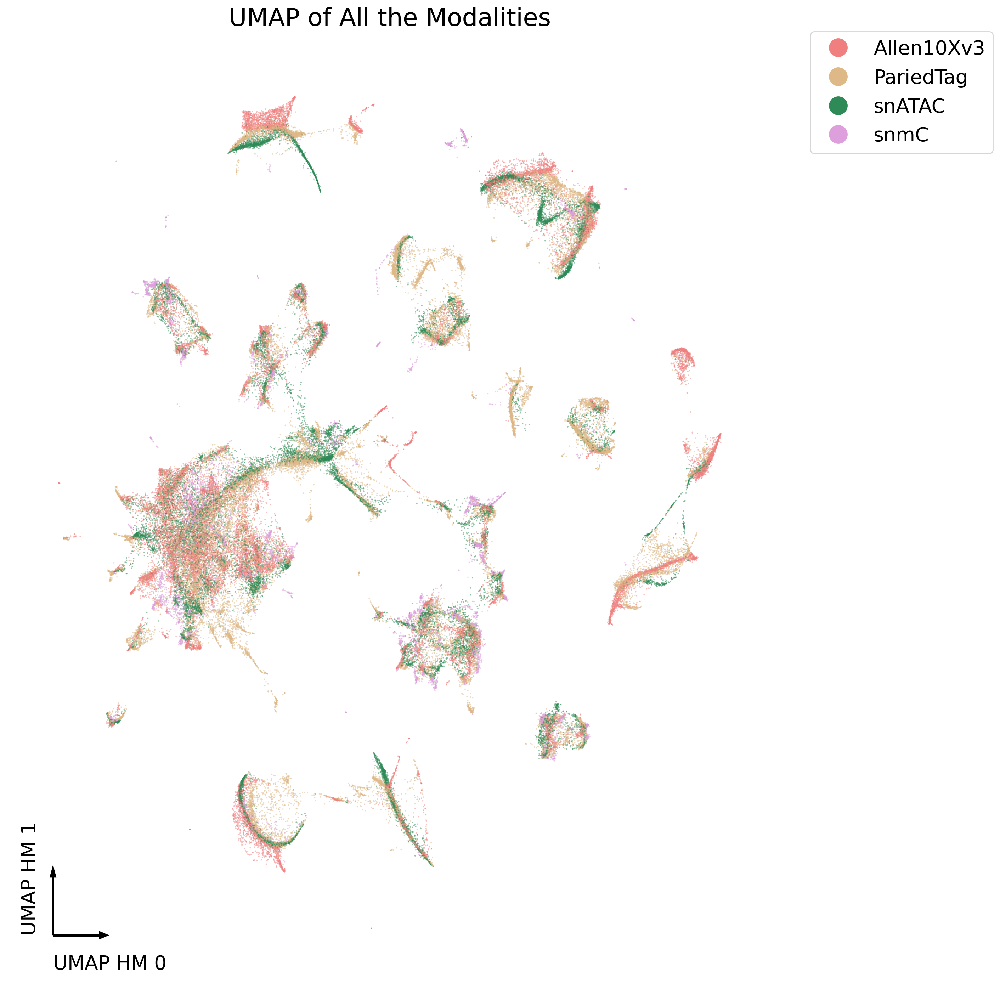

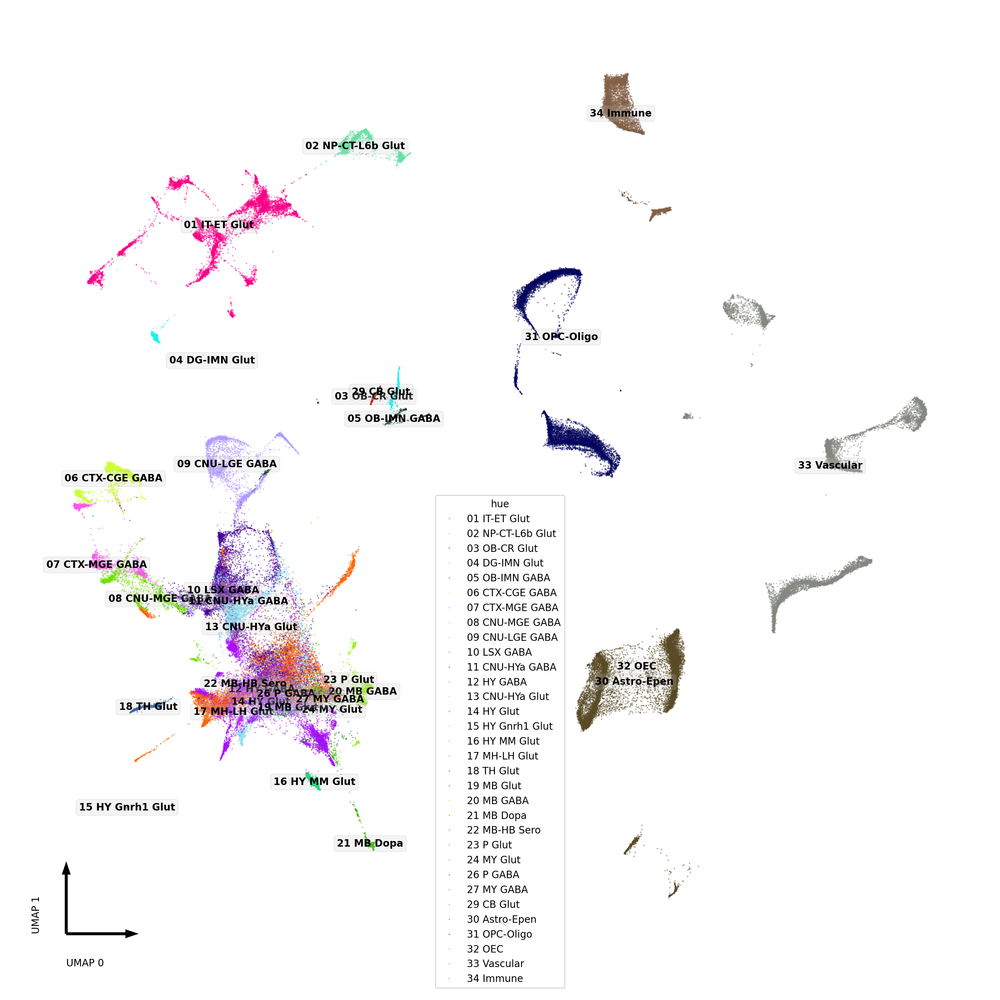

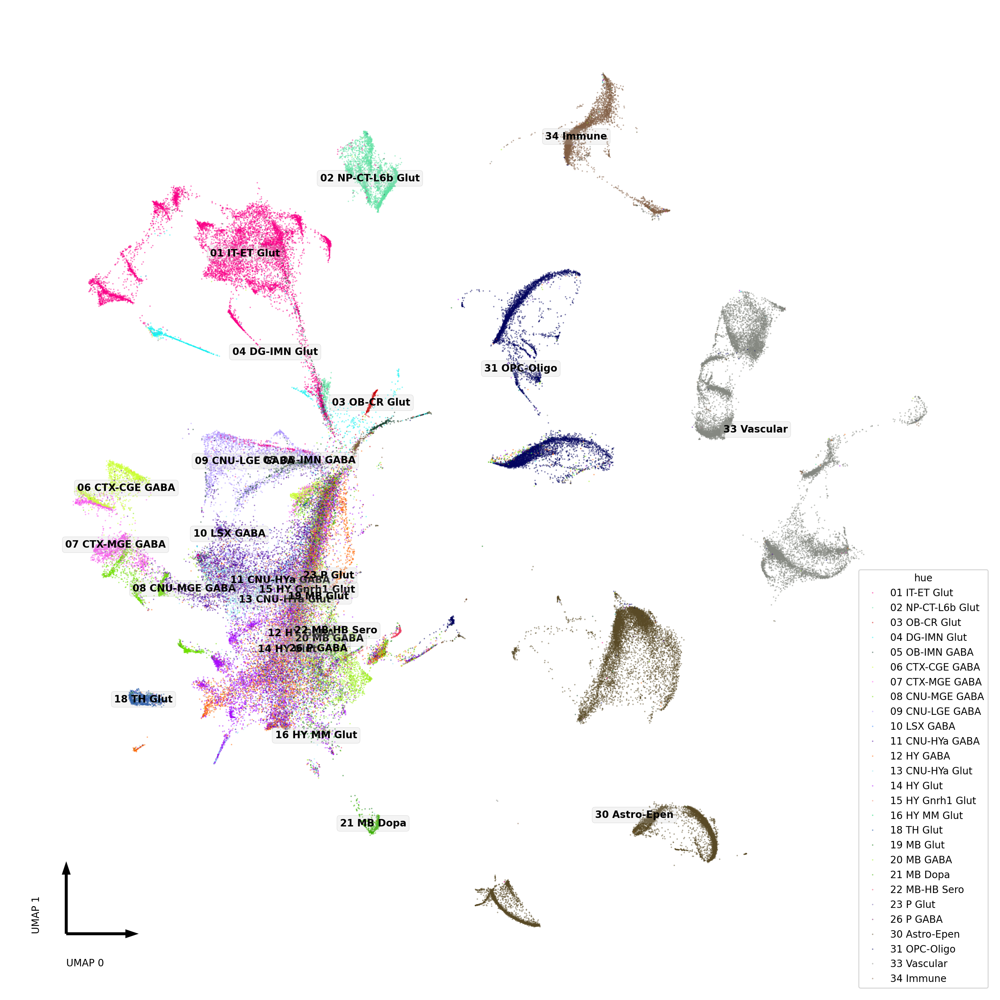

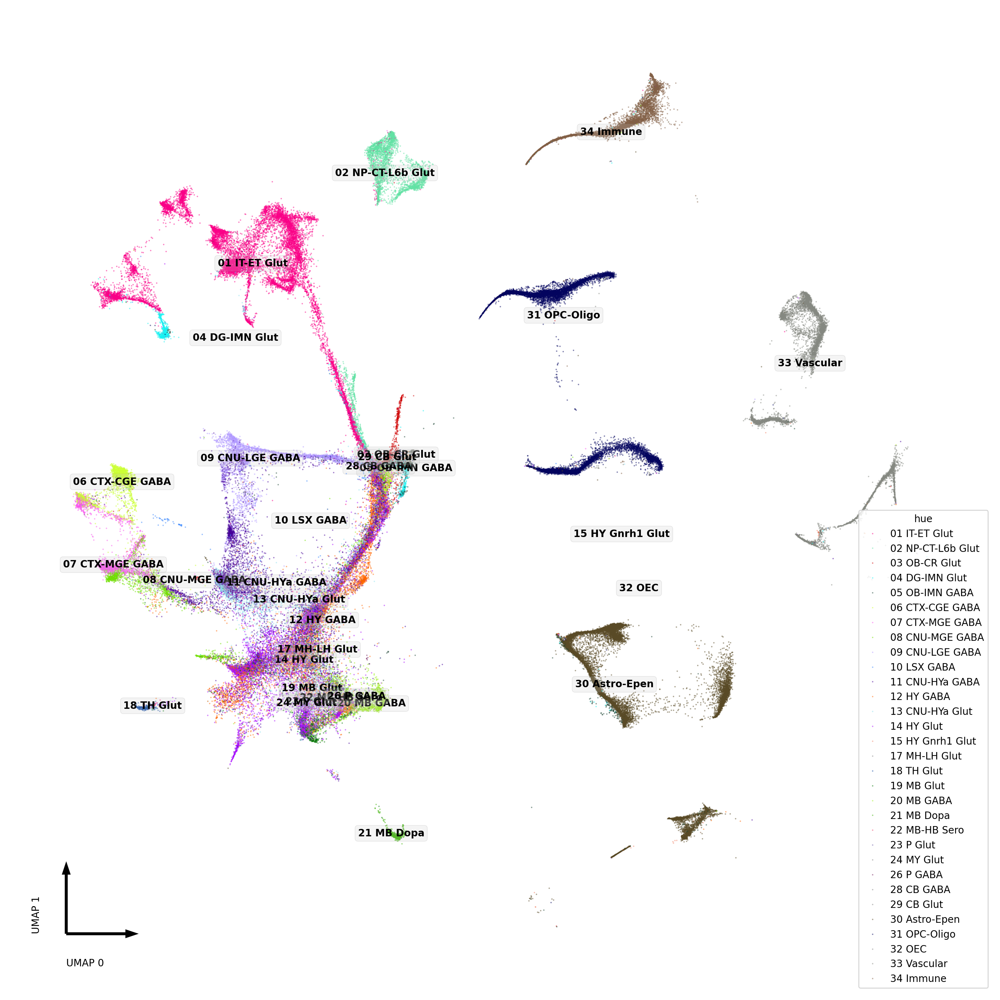

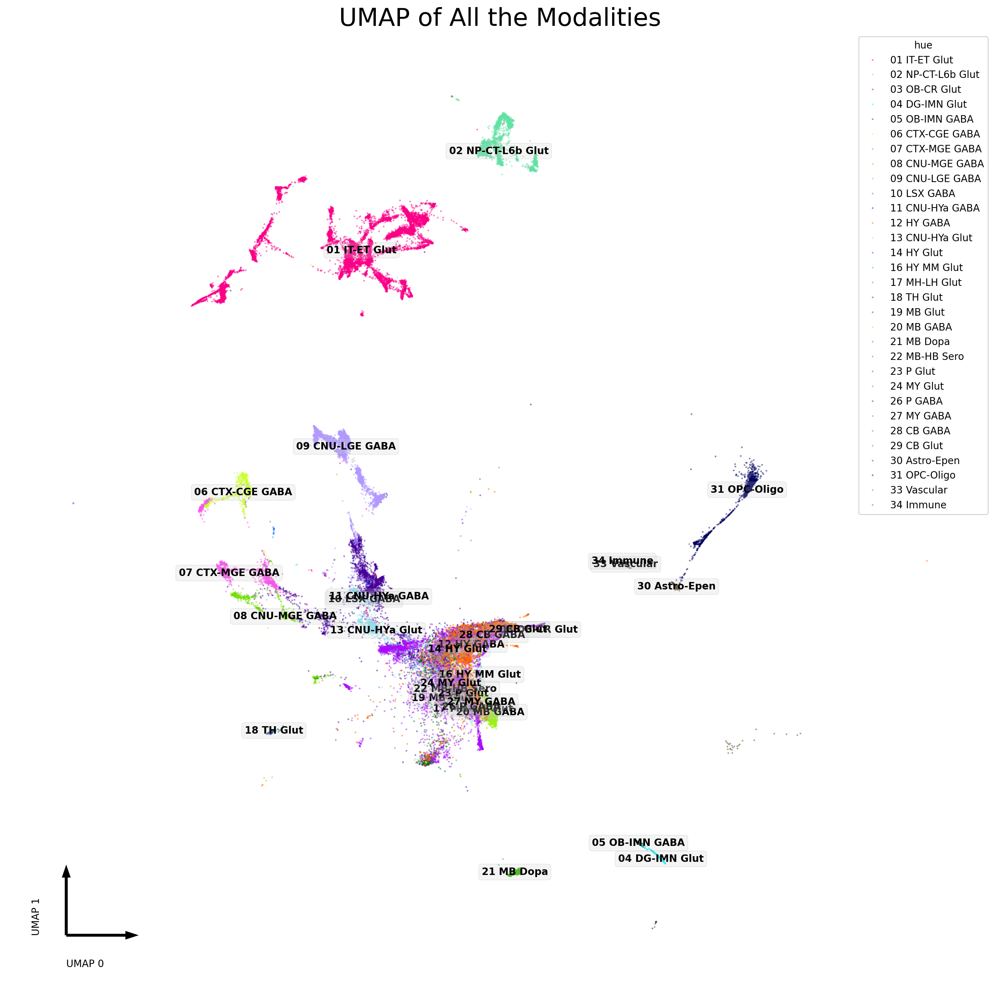

In [18]:
anchord = os.path.join(projd, "03.integration", "out")
annd = os.path.join(gv.pt_projd, "data")
ntop = 7500
npca = 50
prefix = "nneudspt"
suffix = "nneudspt"


ann_intgrn = ad.read_h5ad(
    os.path.join(anchord, "coembed", f"{prefix}.ann.intgrn.umap.class.h5ad"))

ann_intgrn
ann_intgrn.obs.batch.value_counts()
ann_intgrn.obs.batch.unique()

fig, axes = plt.subplots(
        nrows=2, ncols=2, dpi=200, figsize=(14, 14), constrained_layout=True)
colors = ["lightcoral", "burlywood", "seagreen", "plum"]
for i, nm in enumerate(['Allen10Xv3', 'PariedTag', 'snATAC', 'snmC']):
    draw_single_group_umap(d = ann_intgrn[ann_intgrn.obs.batch == nm], 
                      ax = axes[i // 2, i % 2],
                      pal = "auto",
                      color = colors[i],
                      title = nm)

fig, ax = plt.subplots(
        nrows=1, ncols=1, dpi=200, figsize=(14, 14), constrained_layout=True
    )
categorical_scatter(
        data=ann_intgrn,
        coord_base="umap",
        max_points=100000,
        hue="batch",
        palette=colors,
        show_legend=True,
        scatter_kws=dict(color="lightgrey", legend="full", alpha = 0.5),
        ax=ax,
    labelsize = 20,
    )
ax.set_title("UMAP of All the Modalities", fontsize = 25)

fig, axes = plt.subplots(
        nrows=2, ncols=2, dpi=200, figsize=(14, 14), constrained_layout=True)
colors = ["lightcoral", "burlywood", "seagreen", "plum"]
for i, nm in enumerate(['Allen10Xv3', 'PariedTag', 'snATAC', 'snmC']):
    draw_single_group_umap(d = ann_intgrn[ann_intgrn.obs.batch == nm], 
                      ax = axes[i // 2, i % 2],
                      color = colors[i],
                      title = nm,base = "umap_hm")

fig, ax = plt.subplots(
        nrows=1, ncols=1, dpi=200, figsize=(14, 14), constrained_layout=True
    )
categorical_scatter(
        data=ann_intgrn,
        coord_base="umap_hm",
        max_points=100000,
        hue="batch",
        palette=colors,
        show_legend=True,
        scatter_kws=dict(color="lightgrey", legend="full", alpha = 0.5),
        ax=ax,
    labelsize = 20,
    )
ax.set_title("UMAP of All the Modalities", fontsize = 25)

colors = ["lightcoral", "burlywood", "seagreen", "plum"]
for i, nm in enumerate(['Allen10Xv3', 'PariedTag', 'snATAC', 'snmC']):
    fig, ax = plt.subplots(
        nrows=1, ncols=1, dpi=200, figsize=(14, 14), constrained_layout=True)
    a = ann_intgrn[ann_intgrn.obs.batch == nm]
    classes = a.obs["class"].unique()
    local_pal = { k: palette.get(k, "grey") for k in classes}
    categorical_scatter(
        data=ann_intgrn[ann_intgrn.obs.batch == nm],
        coord_base="umap",
        max_points=100000,
        hue="class",
        palette=local_pal,
        show_legend=False,
        scatter_kws=dict(color="lightgrey", legend="full", alpha = 0.5),
        text_anno = "class",
        ax=ax,
    labelsize = 10,
    )
ax.set_title("UMAP of All the Modalities", fontsize = 25)

AnnData object with n_obs × n_vars = 635048 × 50
    obs: 'barcode', 'batch', 'leiden', 'class'
    uns: 'leiden', 'leiden_sizes', 'neighbors', 'paga'
    obsm: 'X_harmony', 'X_umap', 'X_umap_hm', 'raw_pca'
    obsp: 'connectivities', 'distances'

batch
PariedTag     238159
Allen10Xv3    182226
snATAC        162569
snmC           52094
Name: count, dtype: int64

['Allen10Xv3', 'PariedTag', 'snmC', 'snATAC']
Categories (4, object): ['Allen10Xv3', 'PariedTag', 'snATAC', 'snmC']

/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(


Text(0.5, 1.0, 'UMAP of All the Modalities')

/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/categorical_scatter.py:228: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(


Text(0.5, 1.0, 'UMAP of All the Modalities')

/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/text_anno_scatter.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for text, sub_df in data.groupby(anno_col):
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/text_anno_scatter.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for text, sub_df in data.groupby(anno_col):
/projects/ps-renlab2/szu/projects/amb_pairedtag/tmpPypkg/plot/text_anno_scatter.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observe

Text(0.5, 1.0, 'UMAP of All the Modalities')

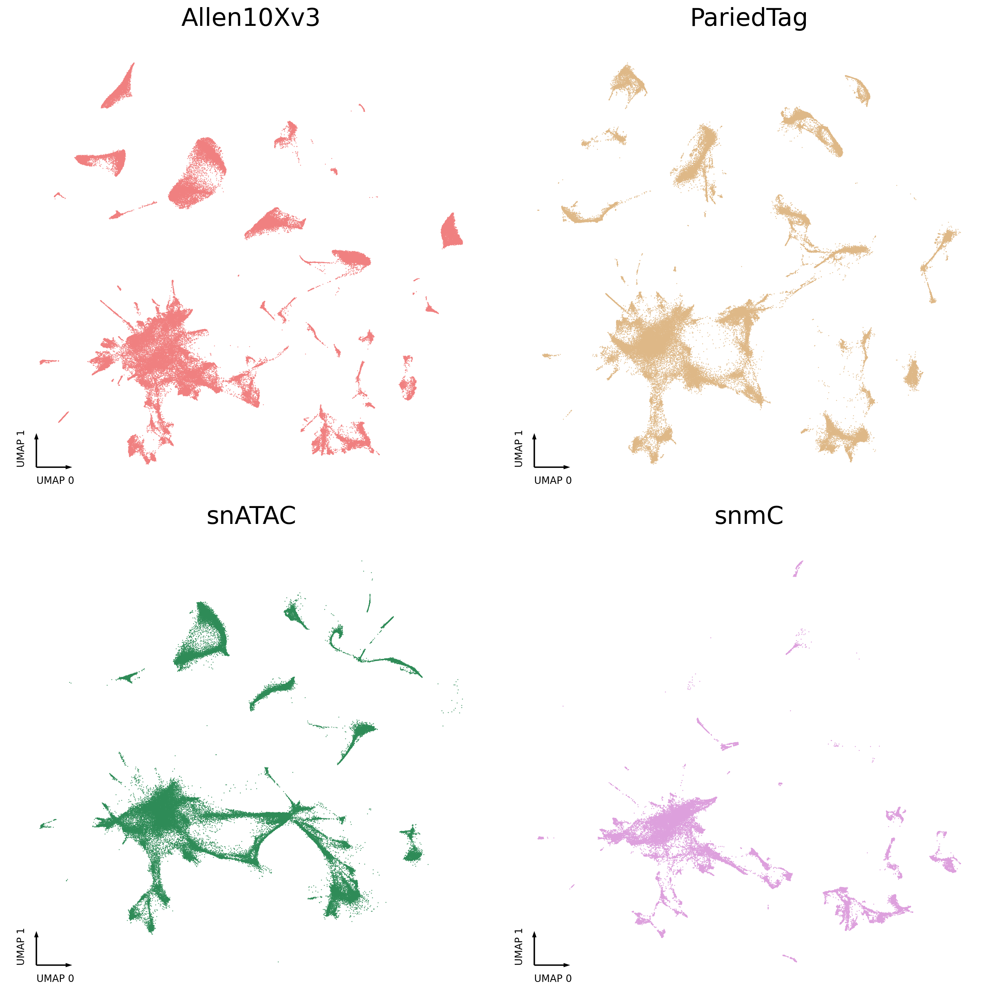

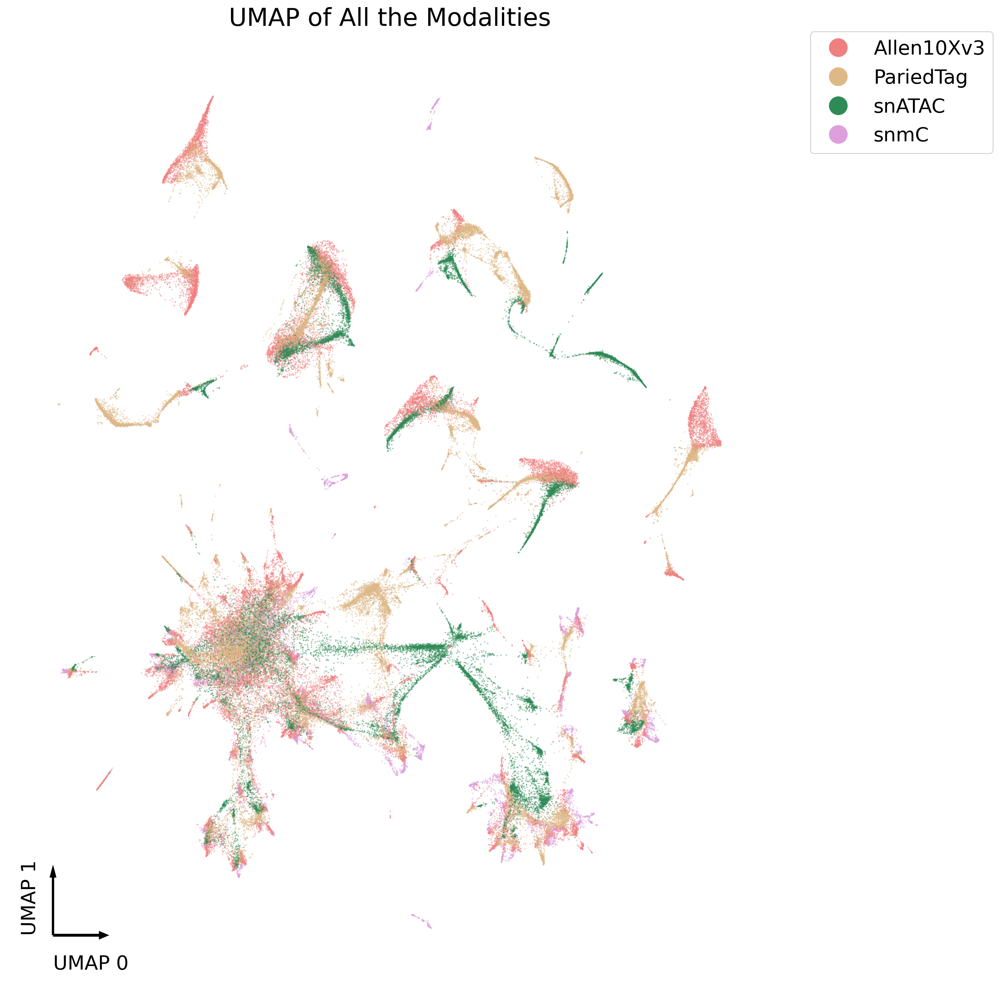

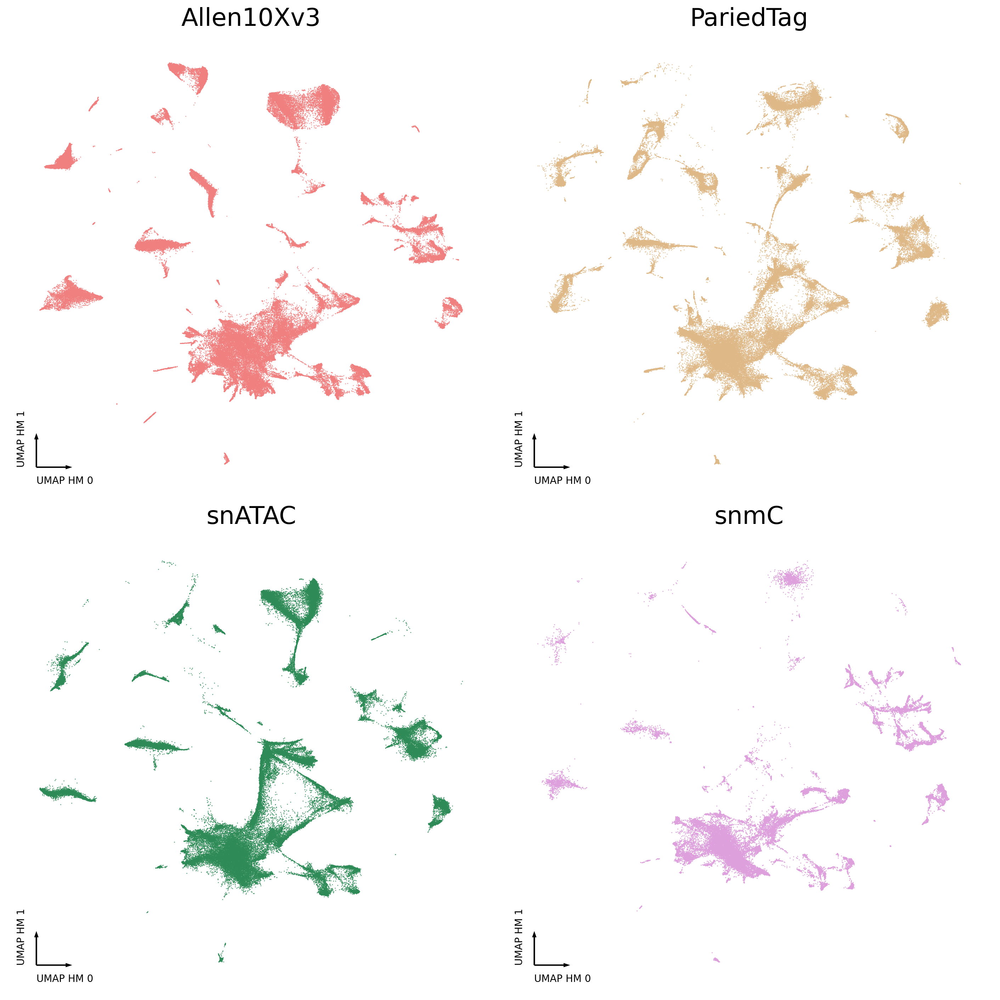

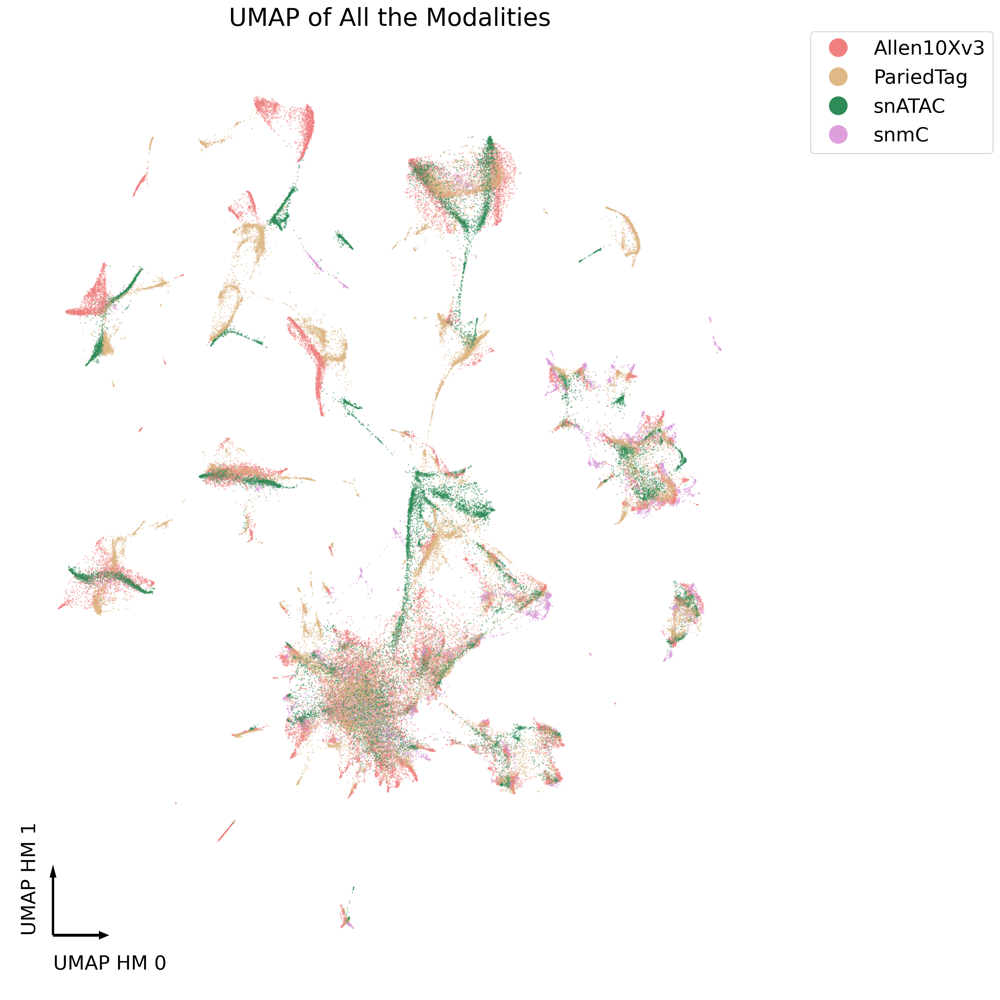

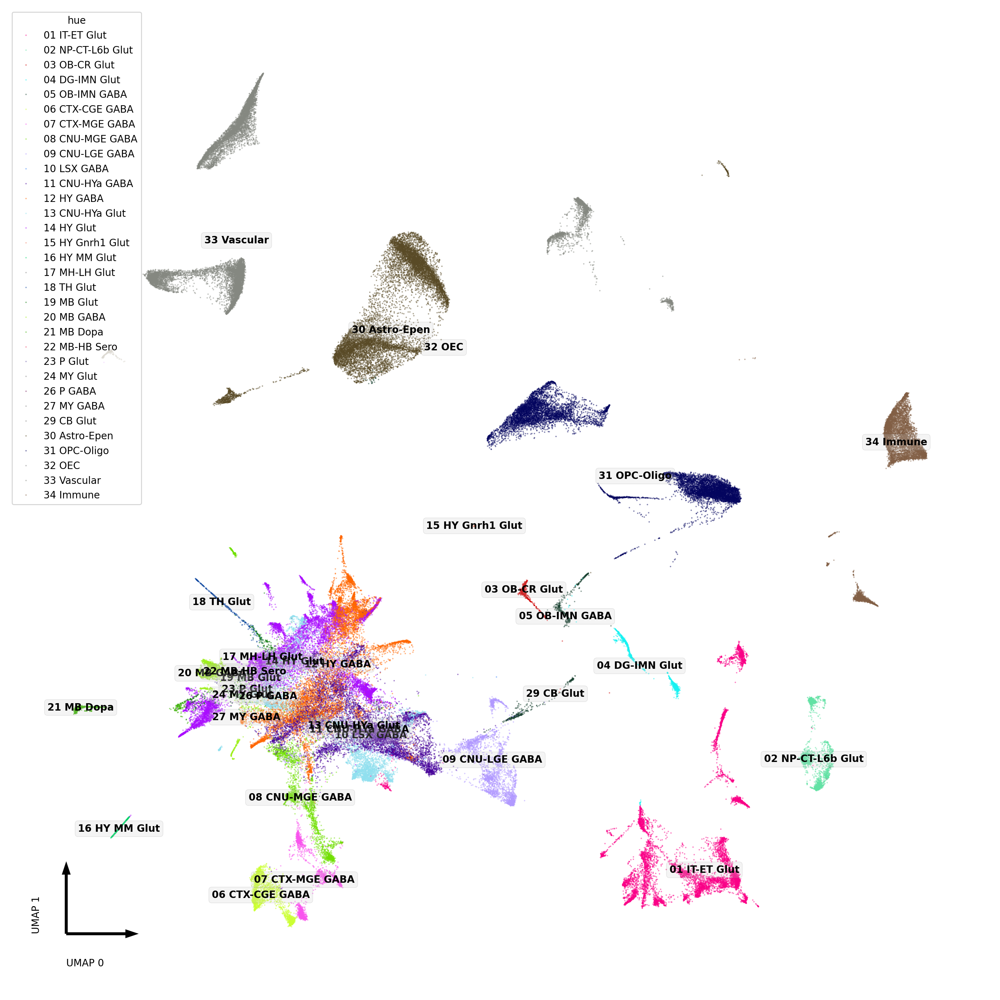

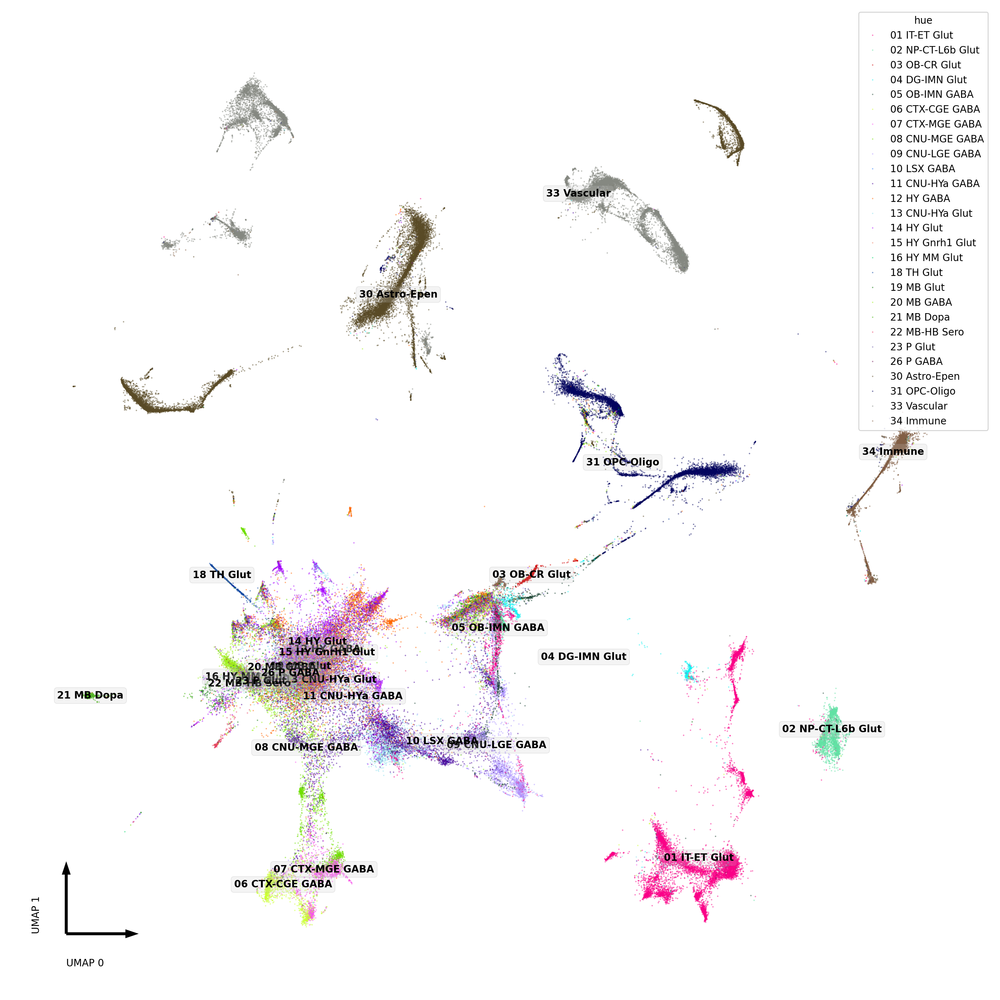

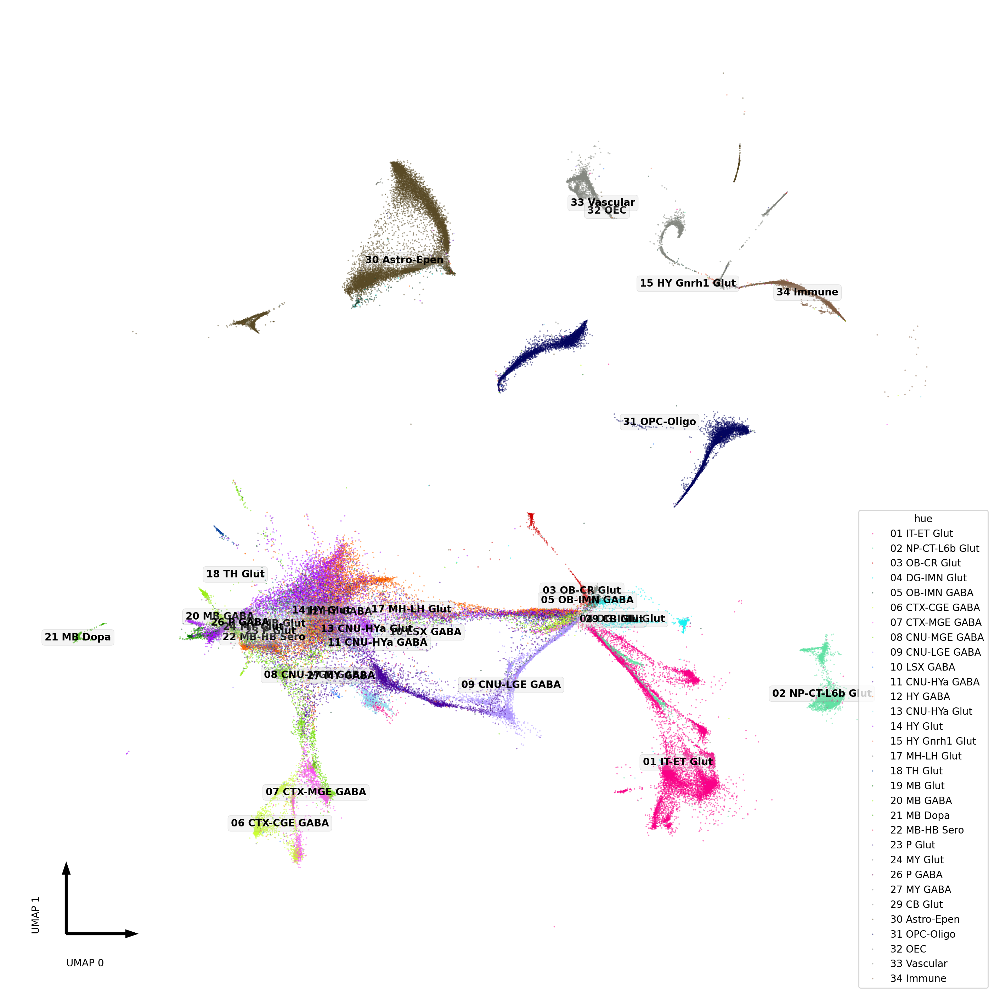

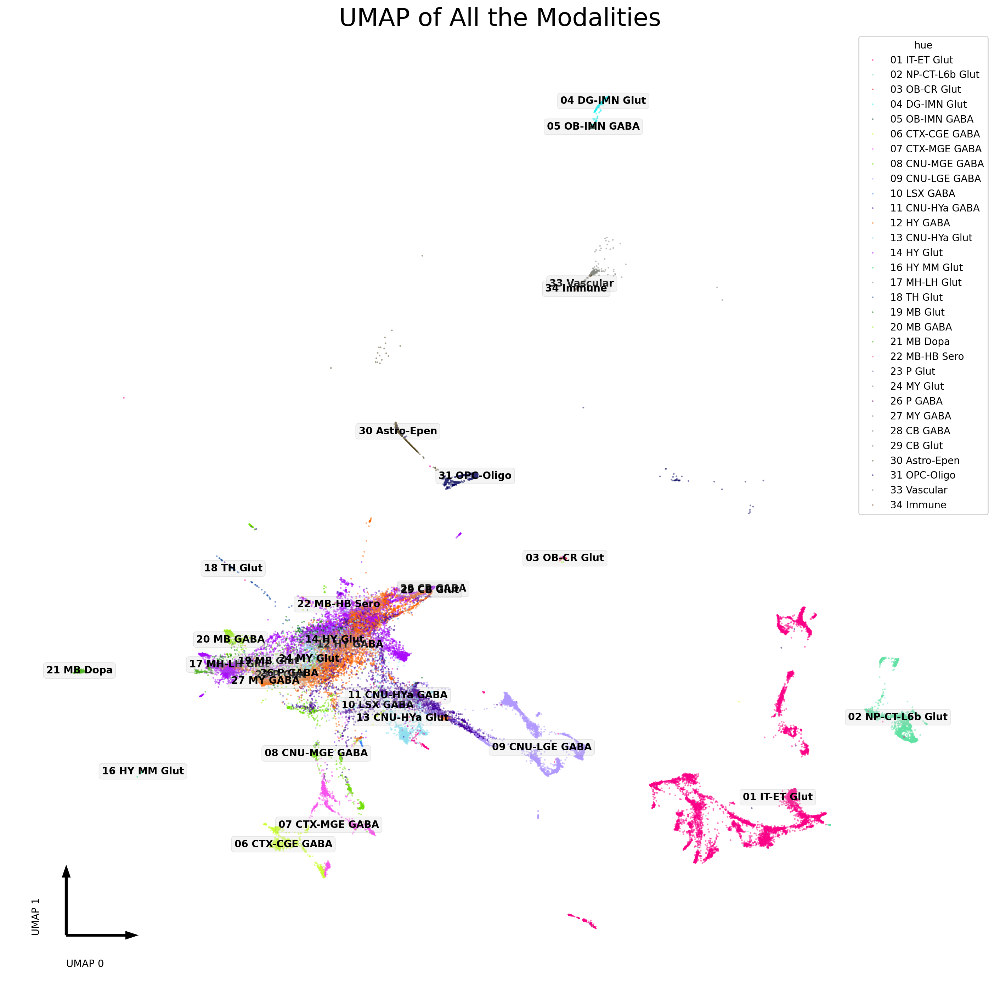

In [17]:
anchord = os.path.join(projd, "03.integration", "out")
annd = os.path.join(gv.pt_projd, "data")
ntop = 7500
npca = 50
prefix = "nneuds"
suffix = "nneuds"


ann_intgrn = ad.read_h5ad(
    os.path.join(anchord, "coembed", f"{prefix}.ann.intgrn.umap.class.h5ad"))

ann_intgrn
ann_intgrn.obs.batch.value_counts()
ann_intgrn.obs.batch.unique()

fig, axes = plt.subplots(
        nrows=2, ncols=2, dpi=200, figsize=(14, 14), constrained_layout=True)
colors = ["lightcoral", "burlywood", "seagreen", "plum"]
for i, nm in enumerate(['Allen10Xv3', 'PariedTag', 'snATAC', 'snmC']):
    draw_single_group_umap(d = ann_intgrn[ann_intgrn.obs.batch == nm], 
                      ax = axes[i // 2, i % 2],
                      pal = "auto",
                      color = colors[i],
                      title = nm)

fig, ax = plt.subplots(
        nrows=1, ncols=1, dpi=200, figsize=(14, 14), constrained_layout=True
    )
categorical_scatter(
        data=ann_intgrn,
        coord_base="umap",
        max_points=100000,
        hue="batch",
        palette=colors,
        show_legend=True,
        scatter_kws=dict(color="lightgrey", legend="full", alpha = 0.5),
        ax=ax,
    labelsize = 20,
    )
ax.set_title("UMAP of All the Modalities", fontsize = 25)

fig, axes = plt.subplots(
        nrows=2, ncols=2, dpi=200, figsize=(14, 14), constrained_layout=True)
colors = ["lightcoral", "burlywood", "seagreen", "plum"]
for i, nm in enumerate(['Allen10Xv3', 'PariedTag', 'snATAC', 'snmC']):
    draw_single_group_umap(d = ann_intgrn[ann_intgrn.obs.batch == nm], 
                      ax = axes[i // 2, i % 2],
                      color = colors[i],
                      title = nm,base = "umap_hm")

fig, ax = plt.subplots(
        nrows=1, ncols=1, dpi=200, figsize=(14, 14), constrained_layout=True
    )
categorical_scatter(
        data=ann_intgrn,
        coord_base="umap_hm",
        max_points=100000,
        hue="batch",
        palette=colors,
        show_legend=True,
        scatter_kws=dict(color="lightgrey", legend="full", alpha = 0.5),
        ax=ax,
    labelsize = 20,
    )
ax.set_title("UMAP of All the Modalities", fontsize = 25)

colors = ["lightcoral", "burlywood", "seagreen", "plum"]
for i, nm in enumerate(['Allen10Xv3', 'PariedTag', 'snATAC', 'snmC']):
    fig, ax = plt.subplots(
        nrows=1, ncols=1, dpi=200, figsize=(14, 14), constrained_layout=True)
    a = ann_intgrn[ann_intgrn.obs.batch == nm]
    classes = a.obs["class"].unique()
    local_pal = { k: palette.get(k, "grey") for k in classes}
    categorical_scatter(
        data=ann_intgrn[ann_intgrn.obs.batch == nm],
        coord_base="umap",
        max_points=100000,
        hue="class",
        palette=local_pal,
        show_legend=False,
        scatter_kws=dict(color="lightgrey", legend="full", alpha = 0.5),
        text_anno = "class",
        ax=ax,
    labelsize = 10,
    )
ax.set_title("UMAP of All the Modalities", fontsize = 25)